In [ ]:

import pandas as pd
import numpy as np
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.compose import ColumnTransformer

import matplotlib.pyplot as plt
import seaborn as sns
import re




In [ ]:

!pip install kaggle

# Upload your kaggle.json file (contains API credentials)
from google.colab import files
files.upload()

# Make directory and move kaggle.json to that directory
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json



Saving kaggle.json to kaggle.json


In [ ]:
!kaggle datasets list -s "Used Cars"

ref                                                           title                               size  lastUpdated          downloadCount  voteCount  usabilityRating  
------------------------------------------------------------  ---------------------------------  -----  -------------------  -------------  ---------  ---------------  
austinreese/craigslist-carstrucks-data                        Used Cars Dataset                  262MB  2021-05-06 17:14:08          90162       1450  1.0              
thedevastator/uncovering-factors-that-affect-used-car-prices  Used Cars                           18MB  2022-12-06 13:36:08           7624         84  1.0              
lepchenkov/usedcarscatalog                                    Used-cars-catalog                  824KB  2019-12-02 12:02:05          14468        147  1.0              
avikasliwal/used-cars-price-prediction                        Used Cars Price Prediction         172KB  2019-06-25 10:26:52          29009        251  0.79

In [ ]:

# Download dataset from Kaggle
!kaggle datasets download -d austinreese/craigslist-carstrucks-data


Dataset URL: https://www.kaggle.com/datasets/austinreese/craigslist-carstrucks-data
License(s): CC0-1.0
 96% 253M/262M [00:01<00:00, 149MB/s]
100% 262M/262M [00:02<00:00, 136MB/s]


In [ ]:

# Unzip the downloaded file
!unzip craigslist-carstrucks-data.zip


Archive:  craigslist-carstrucks-data.zip
  inflating: vehicles.csv            


In [ ]:
# Now you can load the data using pandas
df = pd.read_csv("vehicles.csv", delimiter=',', nrows = 400000)
df.head()

,id,url,region,region_url,price,year,manufacturer,model,condition,cylinders,...,size,type,paint_color,image_url,description,county,state,lat,long,posting_date
0,7222695916,https://prescott.craigslist.org/cto/d/prescott...,prescott,https://prescott.craigslist.org,6000,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,az,NaN,NaN,NaN
1,7218891961,https://fayar.craigslist.org/ctd/d/bentonville...,fayetteville,https://fayar.craigslist.org,11900,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,ar,NaN,NaN,NaN
2,7221797935,https://keys.craigslist.org/cto/d/summerland-k...,florida keys,https://keys.craigslist.org,21000,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,fl,NaN,NaN,NaN
3,7222270760,https://worcester.craigslist.org/cto/d/west-br...,worcester / central MA,https://worcester.craigslist.org,1500,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,ma,NaN,NaN,NaN
4,7210384030,https://greensboro.craigslist.org/cto/d/trinit...,greensboro,https://greensboro.craigslist.org,4900,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,nc,NaN,NaN,NaN


In [ ]:
df.shape

(400000, 26)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 400000 entries, 0 to 399999
Data columns (total 26 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            400000 non-null  int64  
 1   url           400000 non-null  object 
 2   region        400000 non-null  object 
 3   region_url    400000 non-null  object 
 4   price         400000 non-null  int64  
 5   year          398893 non-null  float64
 6   manufacturer  383251 non-null  object 
 7   model         394971 non-null  object 
 8   condition     239173 non-null  object 
 9   cylinders     233725 non-null  object 
 10  fuel          397294 non-null  object 
 11  odometer      395942 non-null  float64
 12  title_status  392912 non-null  object 
 13  transmission  397589 non-null  object 
 14  VIN           246888 non-null  object 
 15  drive         275645 non-null  object 
 16  size          115219 non-null  object 
 17  type          312453 non-null  object 
 18  pain


# **data problems:**


1.   missing values
2.   unnecessary columns
3.   date column



In [ ]:
# check null values
df.isnull().sum()

,0
id,0
url,0
region,0
region_url,0
price,0
year,1107
manufacturer,16749
model,5029
condition,160827
cylinders,166275


In [ ]:
#Columns like id, url, and image_url might not be useful for analysis.
df = df.drop(['id', 'url', 'image_url','region_url','county'], axis=1)

In [ ]:
df.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
region,400000,383,columbus,3608,NaN,NaN,NaN,NaN,NaN,NaN,NaN
price,400000.0,NaN,NaN,NaN,78916.130297,12584943.317448,0.0,5900.0,13900.0,25995.0,3736928711.0
year,398893.0,NaN,NaN,NaN,2011.20521,9.482803,1900.0,2008.0,2013.0,2017.0,2022.0
manufacturer,383251,42,ford,66365,NaN,NaN,NaN,NaN,NaN,NaN,NaN
model,394971,28158,f-150,7508,NaN,NaN,NaN,NaN,NaN,NaN,NaN
condition,239173,6,good,115082,NaN,NaN,NaN,NaN,NaN,NaN,NaN
cylinders,233725,8,6 cylinders,88567,NaN,NaN,NaN,NaN,NaN,NaN,NaN
fuel,397294,5,gas,333506,NaN,NaN,NaN,NaN,NaN,NaN,NaN
odometer,395942.0,NaN,NaN,NaN,98547.92732,217043.613978,0.0,38000.0,86006.0,134000.0,10000000.0
title_status,392912,6,clean,380097,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 400000 entries, 0 to 399999
Data columns (total 21 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   region        400000 non-null  object 
 1   price         400000 non-null  int64  
 2   year          398893 non-null  float64
 3   manufacturer  383251 non-null  object 
 4   model         394971 non-null  object 
 5   condition     239173 non-null  object 
 6   cylinders     233725 non-null  object 
 7   fuel          397294 non-null  object 
 8   odometer      395942 non-null  float64
 9   title_status  392912 non-null  object 
 10  transmission  397589 non-null  object 
 11  VIN           246888 non-null  object 
 12  drive         275645 non-null  object 
 13  size          115219 non-null  object 
 14  type          312453 non-null  object 
 15  paint_color   279294 non-null  object 
 16  description   399932 non-null  object 
 17  state         400000 non-null  object 
 18  lat 

columns with no missing values are 3 columns
region price state

In [ ]:

# Get unique values and their counts for specified columns
for col in ['region', 'price', 'state']:
  print(f"\nUnique values and counts for column '{col}':")
  print(len(df[col].value_counts()))


Unique values and counts for column 'region':
383

Unique values and counts for column 'price':
15046

Unique values and counts for column 'state':
49


# **handling numerical columns**

In [ ]:

# Get a list of numerical columns
numerical_cols = df.select_dtypes(include=np.number).columns.tolist()

numerical_cols

['price', 'year', 'odometer', 'lat', 'long']

Distribution of 'price':


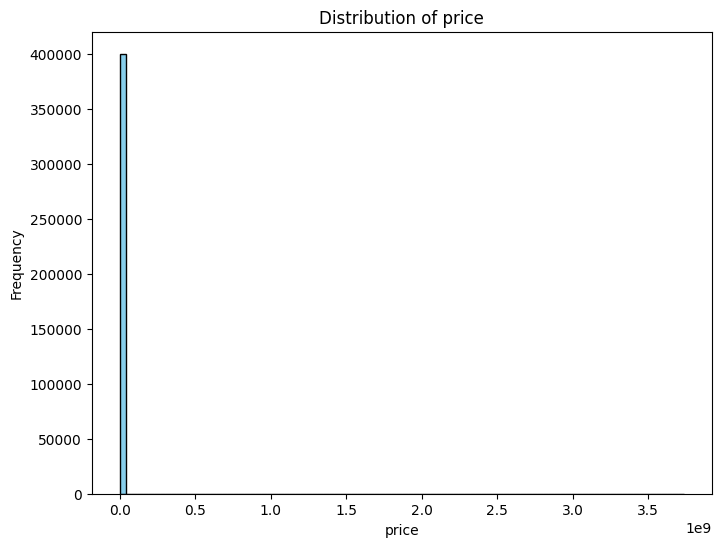

No missing values in 'price'.
Distribution of 'year':


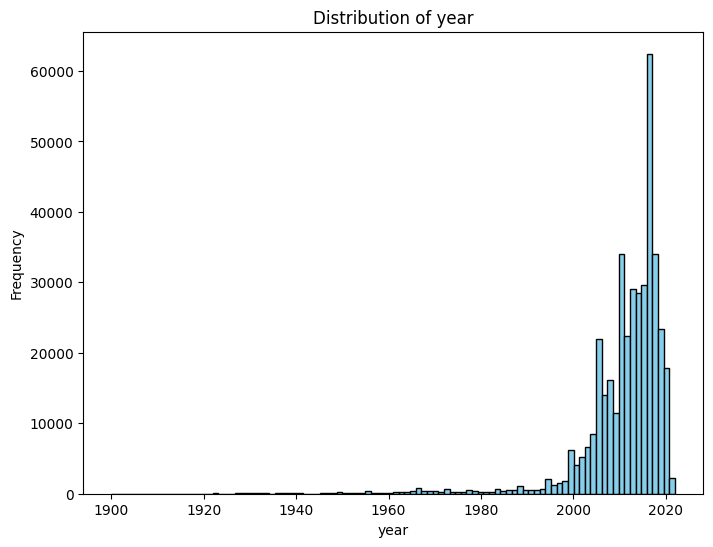

Missing values in 'year': 1107
Imputing with median for year due to high skewness.
Distribution of 'odometer':


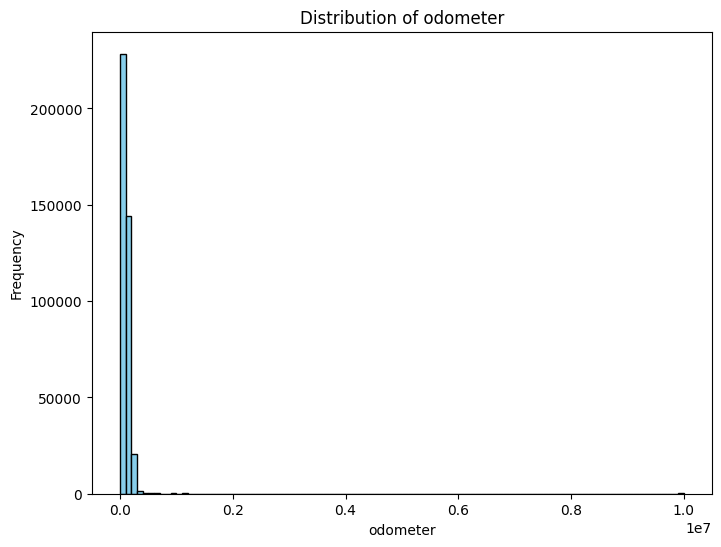

Missing values in 'odometer': 4058
Imputing with median for odometer due to high skewness.
Distribution of 'lat':


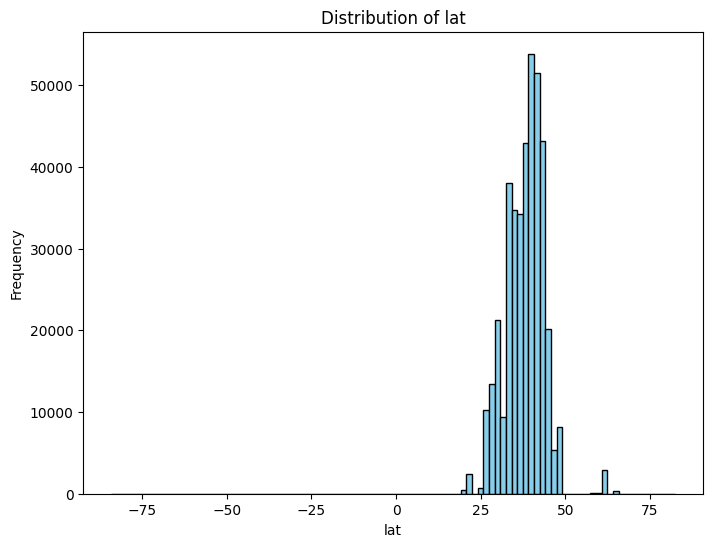

Missing values in 'lat': 6362
Imputing with mean for lat.
Distribution of 'long':


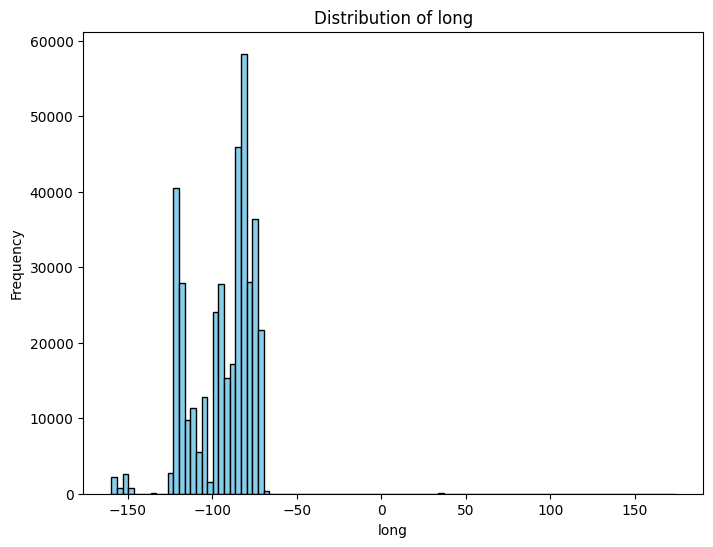

Missing values in 'long': 6362
Imputing with mean for long.


In [ ]:
# visulize distribution of numerical columns and handle missing values according to it

# Iterate through numerical columns and visualize distributions
for col in numerical_cols:
    print(f"Distribution of '{col}':")
    plt.figure(figsize=(8, 6))
    plt.hist(df[col], bins=100, color='skyblue', edgecolor='black')
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.show()

    # Handle missing values based on distribution
    if df[col].isnull().sum() > 0:
        print(f"Missing values in '{col}': {df[col].isnull().sum()}")
        if df[col].skew() > 1 or df[col].skew() < -1:  #Highly skewed
            print(f"Imputing with median for {col} due to high skewness.")

        else:  #Normal or near normal distribution
            print(f"Imputing with mean for {col}.")

    else:
        print(f"No missing values in '{col}'.")

In [ ]:
# imputation to handle missing values in numerical data
imputer_med = SimpleImputer(strategy='median')
imputer_mean = SimpleImputer(strategy='mean')

df['long'] = imputer_mean.fit_transform(df[['long']])
df['lat'] = imputer_mean.fit_transform(df[['lat']])
df['odometer'] = imputer_med.fit_transform(df[['odometer']])
df['year'] = imputer_med.fit_transform(df[['year']])


In [ ]:
print(f"Missing values in data after imputation: {df.isnull().sum()}")

Missing values in data after imputation: region               0
price                0
year                 0
manufacturer     16749
model             5029
condition       160827
cylinders       166275
fuel              2706
odometer             0
title_status      7088
transmission      2411
VIN             153112
drive           124355
size            284781
type             87547
paint_color     120706
description         68
state                0
lat                  0
long                 0
posting_date        66
dtype: int64


# **handling missing values in categorical columns**

In [ ]:
df['description'] = df['description'].fillna('No description')

In [ ]:
df.isnull().sum()

,0
region,0
price,0
year,0
manufacturer,16749
model,5029
condition,160827
cylinders,166275
fuel,2706
odometer,0
title_status,7088


In [ ]:

# Get categorical columns with missing values
categorical_cols_with_missing = df.select_dtypes(include=['object']).columns[df.select_dtypes(include=['object']).isnull().any()].tolist()

categorical_cols_with_missing

['manufacturer',
 'model',
 'condition',
 'cylinders',
 'fuel',
 'title_status',
 'transmission',
 'VIN',
 'drive',
 'size',
 'type',
 'paint_color',
 'posting_date']

In [ ]:

# Drop duplicate rows
df = df.drop_duplicates()

# Verify that duplicates have been removed
duplicates = df.duplicated()
print(f"Number of duplicate rows after dropping: {duplicates.sum()}")

Number of duplicate rows after dropping: 0


In [ ]:

# Get unique values and their counts for categorical columns with missing values
for col in categorical_cols_with_missing:
    print(f"\nmissing values on '{col}': {df[col].isnull().sum()} ")
    print(f"\nUnique values and counts for column '{col}': {df[col].nunique()}")
    print(df[col].value_counts())


missing values on 'manufacturer': 16738 

Unique values and counts for column 'manufacturer': 42
manufacturer
ford               66363
chevrolet          51505
toyota             32162
honda              20128
nissan             18158
jeep               17510
ram                16571
gmc                15441
bmw                13525
dodge              12778
mercedes-benz      11309
hyundai             9830
volkswagen          8836
subaru              8757
kia                 8021
lexus               7838
audi                7082
cadillac            6572
chrysler            5712
acura               5703
buick               5186
mazda               5112
infiniti            4580
lincoln             4043
volvo               3231
mitsubishi          2955
mini                2258
pontiac             2144
rover               1938
jaguar              1853
porsche             1249
mercury             1120
saturn              1010
alfa-romeo           845
tesla                812
fiat          

In [ ]:
# Check for duplicates
duplicates = df.duplicated()
print(f"Number of duplicate rows: {duplicates.sum()}")



Number of duplicate rows: 0


In [ ]:

# Impute missing values in categorical columns with 'unknown'

print(f"Missing values in data after imputation: {df.isnull().sum()}")

Missing values in data after imputation: region               0
price                0
year                 0
manufacturer     16738
model             5018
condition       160810
cylinders       166258
fuel              2695
odometer             0
title_status      7077
transmission      2400
VIN             153101
drive           124343
size            284765
type             87536
paint_color     120694
description          0
state                0
lat                  0
long                 0
posting_date        55
dtype: int64


In [ ]:



data = df.copy()

# Define a function to extract matches for a column
def fill_missing_from_description(column, description_column):
    # Precompute unique non-null values for the column
    unique_values = data[column].dropna().unique()
    unique_values_lower = {val: val.lower() for val in unique_values}  # Create a lowercase mapping

    # Define a function to find a match in the description
    def find_match(description):
        for key, value in unique_values_lower.items():
            if value in description.lower():
                return key
        return 'unknown'  # Default if no match is found

    # Apply the match function only to rows with missing values in the column
    data[column] = data[column].fillna(data[description_column].apply(find_match))

# Apply the function to the desired columns
for col in ['manufacturer', 'title_status','paint_color','condition' ,'drive' ,'size']:
    fill_missing_from_description(col, 'description')

# Check missing values
print(f"Missing values in data after imputation:\n{data.isnull().sum()}")


Missing values in data after imputation:
region               0
price                0
year                 0
manufacturer         0
model             5018
condition            0
cylinders       166258
fuel              2695
odometer             0
title_status         0
transmission      2400
VIN             153101
drive                0
size                 0
type             87536
paint_color          0
description          0
state                0
lat                  0
long                 0
posting_date        55
dtype: int64


In [ ]:
# Display unique values and their counts
for col in ['manufacturer', 'title_status','paint_color','condition' ,'drive' ,'size']:
    print(f"\nUnique values and counts for column '{col}':")
    print(data[col].value_counts())


Unique values and counts for column 'manufacturer':
manufacturer
ford               67562
chevrolet          52037
toyota             33538
honda              20256
ram                19059
nissan             18288
jeep               17667
gmc                17049
bmw                13591
dodge              12869
mercedes-benz      11370
hyundai             9887
volkswagen          8875
subaru              8799
kia                 8037
lexus               7896
audi                7554
unknown             7475
cadillac            6616
chrysler            5783
acura               5713
mazda               5221
buick               5217
infiniti            4590
lincoln             4095
volvo               3284
mitsubishi          2985
mini                2417
pontiac             2169
rover               1945
jaguar              1874
porsche             1272
mercury             1138
saturn              1014
alfa-romeo           845
tesla                817
fiat                 773
harley-da

In [ ]:
# Apply the function to the desired columns
fill_missing_from_description('model', 'description')

# Check missing values
print(f"Missing values in data after imputation:\n{data.isnull().sum()}")


Missing values in data after imputation:
region               0
price                0
year                 0
manufacturer         0
model                0
condition            0
cylinders       166258
fuel              2695
odometer             0
title_status         0
transmission      2400
VIN             153101
drive                0
size                 0
type             87536
paint_color          0
description          0
state                0
lat                  0
long                 0
posting_date        55
dtype: int64


In [ ]:

for col in ['type', 'cylinders', 'fuel', 'transmission']:
    # Precompute unique non-null values for the column, excluding 'other'
    unique_values = data[col].dropna().unique()
    unique_values = [val for val in unique_values if val.lower() != 'other']
    unique_values_lower = {val: val.lower() for val in unique_values}

    # Define a function to find a match in the description
    def find_match(description):
        for key, value in unique_values_lower.items():
            if value in description.lower():
                return key
        return 'other'  # Default to 'other' if no match is found among the filtered values

    # Apply the match function only to rows with missing values in the column
    data[col] = data[col].fillna(data['description'].apply(find_match))

# Check missing values
print(f"Missing values in data after imputation:\n{data.isnull().sum()}")

# Display unique values and their counts
for col in ['type', 'cylinders', 'fuel', 'transmission']:
    print(f"\nUnique values and counts for column '{col}':")
    print(data[col].value_counts())

Missing values in data after imputation:
region               0
price                0
year                 0
manufacturer         0
model                0
condition            0
cylinders            0
fuel                 0
odometer             0
title_status         0
transmission         0
VIN             153101
drive                0
size                 0
type                 0
paint_color          0
description          0
state                0
lat                  0
long                 0
posting_date        55
dtype: int64

Unique values and counts for column 'type':
type
sedan          86203
SUV            76498
other          60719
pickup         50475
truck          49228
coupe          19416
hatchback      16374
van            14391
wagon          10590
convertible     8116
mini-van        4513
bus             2802
offroad          658
Name: count, dtype: int64

Unique values and counts for column 'cylinders':
cylinders
other           164566
6 cylinders      89196
4 cylind

In [ ]:
#data = data.drop(['VIN'], axis=1)


In [ ]:

nan_posting_date = data[data['posting_date'].isnull()]
print(nan_posting_date[['posting_date', 'description']])
print(len(nan_posting_date))

       posting_date     description
0               NaN  No description
1               NaN  No description
2               NaN  No description
3               NaN  No description
4               NaN  No description
5               NaN  No description
6               NaN  No description
7               NaN  No description
8               NaN  No description
9               NaN  No description
10              NaN  No description
15              NaN  No description
16              NaN  No description
17              NaN  No description
18              NaN  No description
19              NaN  No description
24              NaN  No description
25              NaN  No description
26              NaN  No description
30184           NaN  No description
33948           NaN  No description
63236           NaN  No description
70037           NaN  No description
72478           NaN  No description
80766           NaN  No description
80767           NaN  No description
80768           NaN  No desc

In [ ]:

# Drop rows with NaN values in the 'posting_date' column
data = data.dropna(subset=['posting_date'])

# Verify the change
print(f"Missing values in data after dropping NaN 'posting_date':\n{data.isnull().sum()}")

Missing values in data after dropping NaN 'posting_date':
region               0
price                0
year                 0
manufacturer         0
model                0
condition            0
cylinders            0
fuel                 0
odometer             0
title_status         0
transmission         0
VIN             153046
drive                0
size                 0
type                 0
paint_color          0
description          0
state                0
lat                  0
long                 0
posting_date         0
dtype: int64


In [ ]:
# Check for duplicates
duplicates = data.duplicated()
print(f"Number of duplicate rows: {duplicates.sum()}")

Number of duplicate rows: 0


## **EDA**

In [ ]:

# Reset index after dropping rows
data = data.reset_index(drop=True)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 399928 entries, 0 to 399927
Data columns (total 21 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   region        399928 non-null  object 
 1   price         399928 non-null  int64  
 2   year          399928 non-null  float64
 3   manufacturer  399928 non-null  object 
 4   model         399928 non-null  object 
 5   condition     399928 non-null  object 
 6   cylinders     399928 non-null  object 
 7   fuel          399928 non-null  object 
 8   odometer      399928 non-null  float64
 9   title_status  399928 non-null  object 
 10  transmission  399928 non-null  object 
 11  VIN           246882 non-null  object 
 12  drive         399928 non-null  object 
 13  size          399928 non-null  object 
 14  type          399928 non-null  object 
 15  paint_color   399928 non-null  object 
 16  description   399928 non-null  object 
 17  state         399928 non-null  object 
 18  lat 

questions to answer


1.   What is the distribution of vehicle prices?    done
2.   What is the relationship between vehicle age and price? done
3.   What are the most common vehicle types in each region? done
4.   How does odometer reading correlate with price? done
5.   What conditions of vehicles are most common for listings? done
6.   How does transmission type vary by region?
7.   Are there any duplicate VINs in the dataset?
         - Duplicate VINs might indicate errors or fraud
8.   What manufacturers dominate the listings? done
9.   What manufacturers with higher prices? done
10.  How does fuel type influence price?
11.  what is the distribution of vechiles over time?  done
12.  what are distribution of prices over years?    done



In [ ]:
data.describe()

,price,year,odometer,lat,long
count,3.999280e+05,399928.000000,3.999280e+05,399928.000000,399928.000000
mean,7.892811e+04,2011.209808,9.842317e+04,38.038322,-94.028635
std,1.258608e+07,9.470934,2.159627e+05,5.667690,18.124965
min,0.000000e+00,1900.000000,0.000000e+00,-84.122245,-159.827728
25%,5.900000e+03,2008.000000,3.846775e+04,34.210000,-108.481000
50%,1.390000e+04,2013.000000,8.600600e+04,38.661045,-87.680000
75%,2.599500e+04,2017.000000,1.331570e+05,41.780300,-80.425219
max,3.736929e+09,2022.000000,1.000000e+07,82.390818,173.885502


# ***what is the distribution of vechiles over time?***

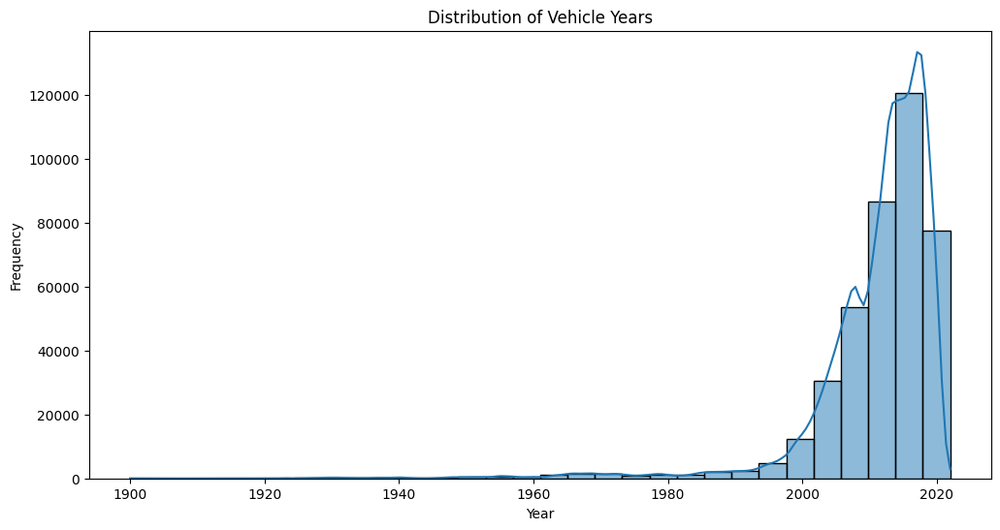

In [ ]:
#when vechiles are common? (what is the distribution of vechiles over time?)

# Distribution of years
plt.figure(figsize=(12, 6))
sns.histplot(data['year'], kde=True, bins=30)
plt.title('Distribution of Vehicle Years')
plt.xlabel('Year')
plt.ylabel('Frequency')
plt.show()

# ***Distribution of prices***

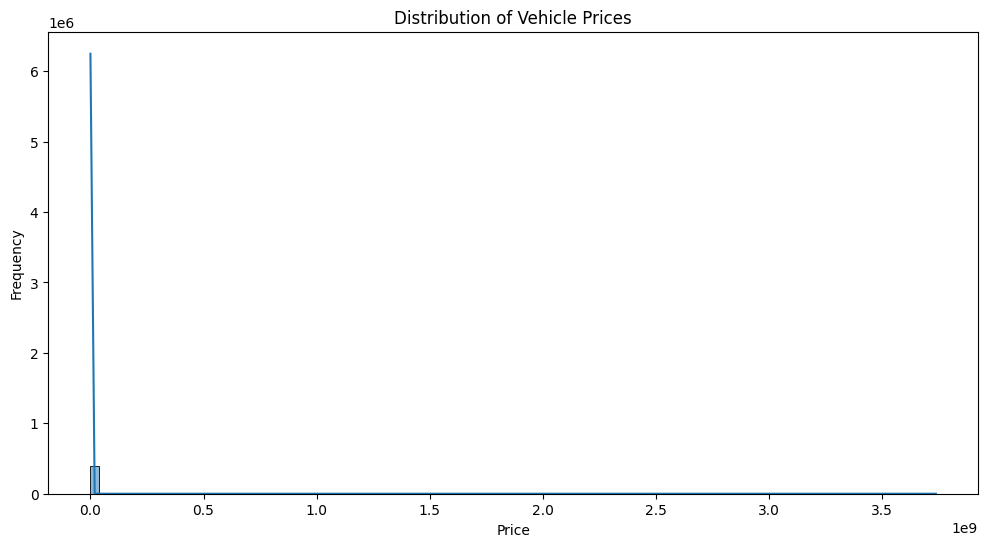

In [ ]:

# Distribution of prices
plt.figure(figsize=(12, 6))
sns.histplot(data['price'], kde=True, bins=100)
plt.title('Distribution of Vehicle Prices')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()

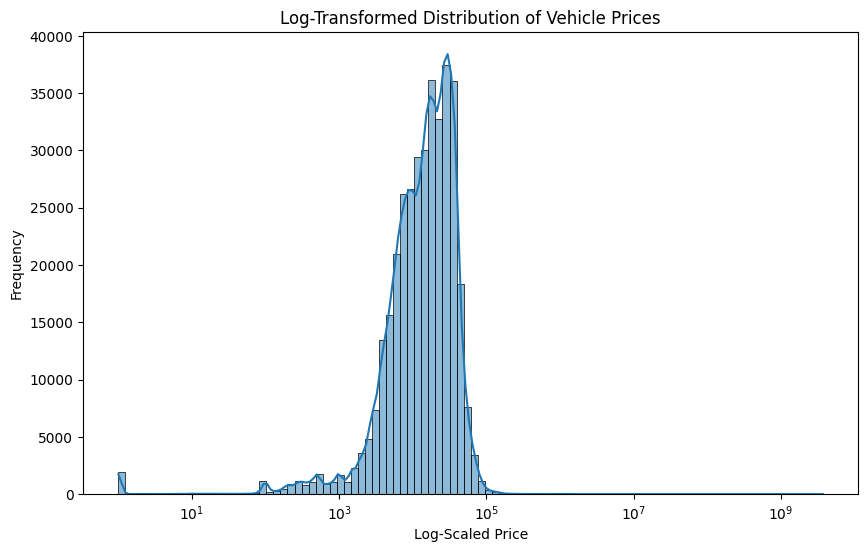

In [ ]:
# Filter prices to exclude zero or invalid prices
valid_prices = data['price'][data['price'] > 0]

# Plot the histogram with a log scale
plt.figure(figsize=(10, 6))
sns.histplot(valid_prices, bins=100, kde=True, log_scale=(True, False))  # Log-scale x-axis
plt.title('Log-Transformed Distribution of Vehicle Prices')
plt.xlabel('Log-Scaled Price')
plt.ylabel('Frequency')
plt.show()

# ***prices over years***

<ipython-input-61-c1849e69ef2e>:8: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(x='year', y='price', data=filtered_data, scale='width')


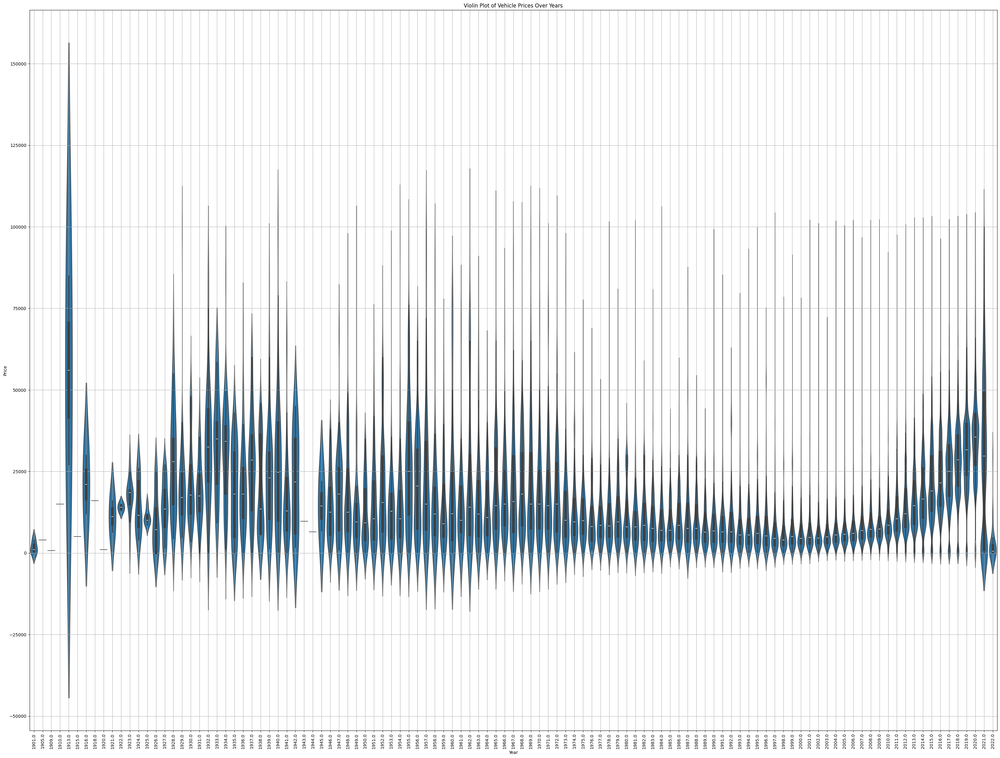

In [ ]:

#what are distribution of prices over years?

# Filter out unreasonable prices and years
filtered_data = data[(data['price'] > 0) & (data['price'] <= 100000) & (data['year'] > 1900)]

plt.figure(figsize=(40, 30))
sns.violinplot(x='year', y='price', data=filtered_data, scale='width')
plt.grid(True)
plt.xticks(rotation=90)
plt.title('Violin Plot of Vehicle Prices Over Years')
plt.xlabel('Year')
plt.ylabel('Price')
plt.show()


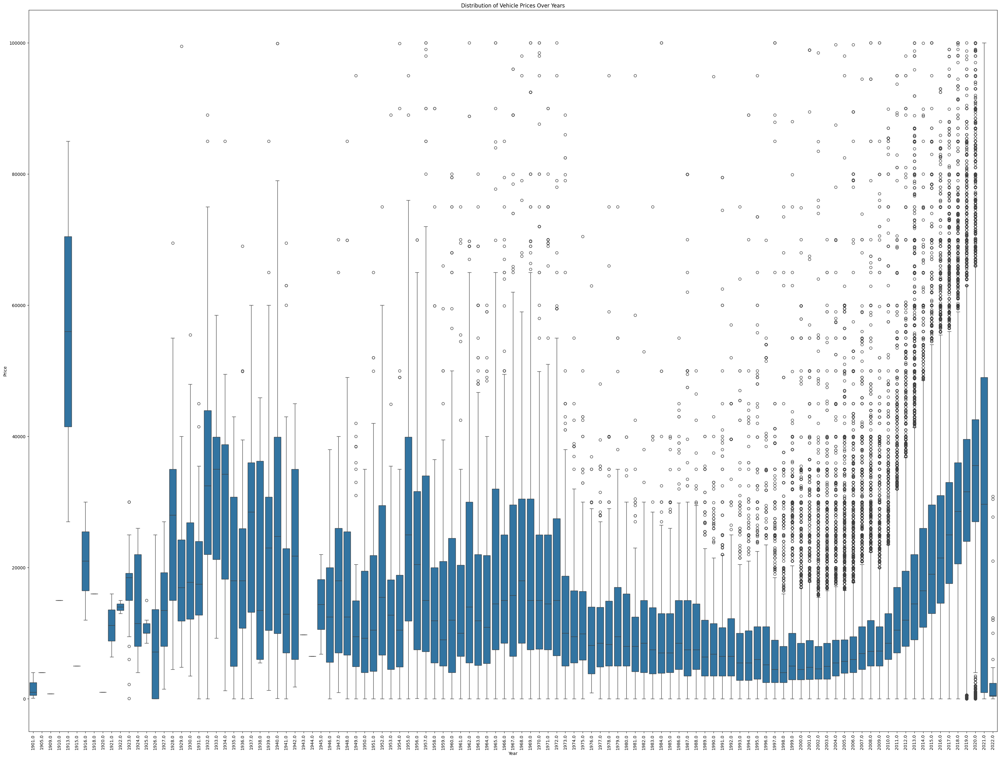

In [ ]:
# Create a boxplot of prices over years
plt.figure(figsize=(40, 30))
sns.boxplot(x='year', y='price', data=filtered_data)
plt.xticks(rotation=90)  # Rotate x-axis labels for better visibility
plt.title('Distribution of Vehicle Prices Over Years')
plt.xlabel('Year')
plt.ylabel('Price')
plt.show()

# ***listings by region***

In [ ]:
# Count listings by region
region_counts = data['region'].value_counts()
print(region_counts.head(10))

region
columbus                  3608
jacksonville              3562
eugene                    2985
fresno / madera           2983
orlando                   2983
bend                      2982
omaha / council bluffs    2982
nashville                 2980
salem                     2980
oklahoma city             2979
Name: count, dtype: int64


# ***age vs. price***

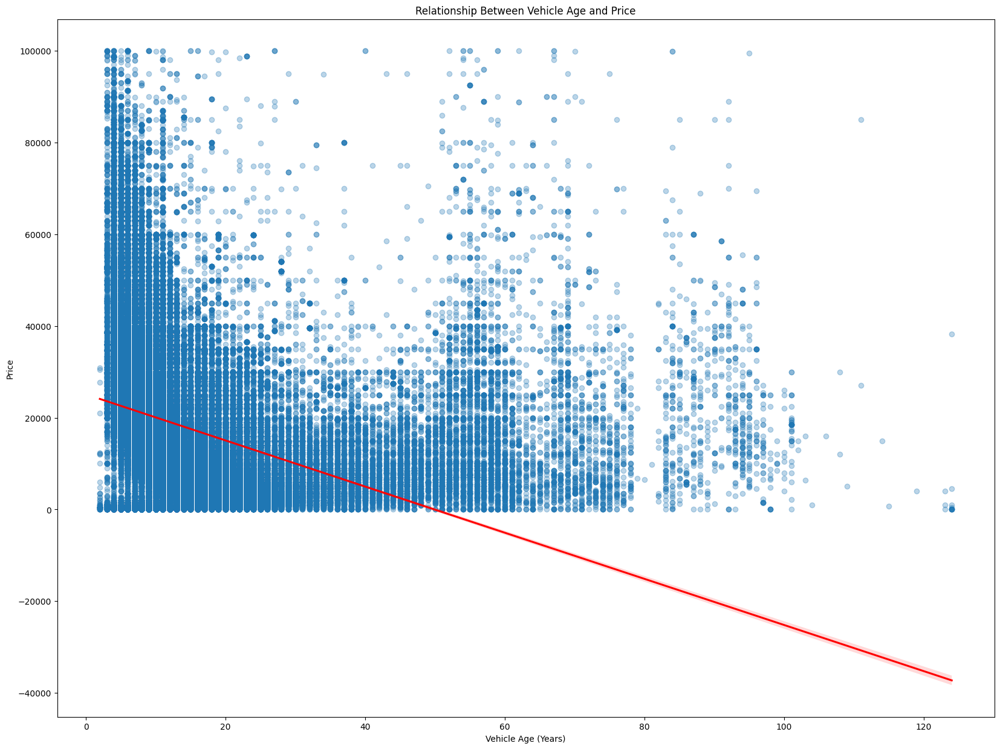

In [ ]:
# Calculate vehicle age
from datetime import datetime

# Assuming the current year
current_year = datetime.now().year

# Calculate vehicle age
data['vehicle_age'] = current_year - data['year']

# Filter out invalid data
filtered_data = data[(data['vehicle_age'] >= 0) & (data['price'] > 0) & (data['price'] <= 100000)]
# Scatter plot of age vs. price
plt.figure(figsize=(20, 15))
sns.regplot(x='vehicle_age', y='price', data=filtered_data, scatter_kws={'alpha': 0.3}, line_kws={"color": "red"})
plt.title('Relationship Between Vehicle Age and Price')
plt.xlabel('Vehicle Age (Years)')
plt.ylabel('Price')
plt.show()


# ***top vehicle types per region***

In [ ]:
#What are the most common vehicle types in each region?
# Find top vehicle types per region
top_types = data.groupby('region')['type'].agg(lambda x: x.value_counts().idxmax())
print(top_types)

region
SF bay area                sedan
abilene                   pickup
akron / canton               SUV
albany                     sedan
albuquerque                other
                           ...  
york                       sedan
youngstown                 sedan
yuba-sutter                sedan
yuma                      pickup
zanesville / cambridge       SUV
Name: type, Length: 381, dtype: object


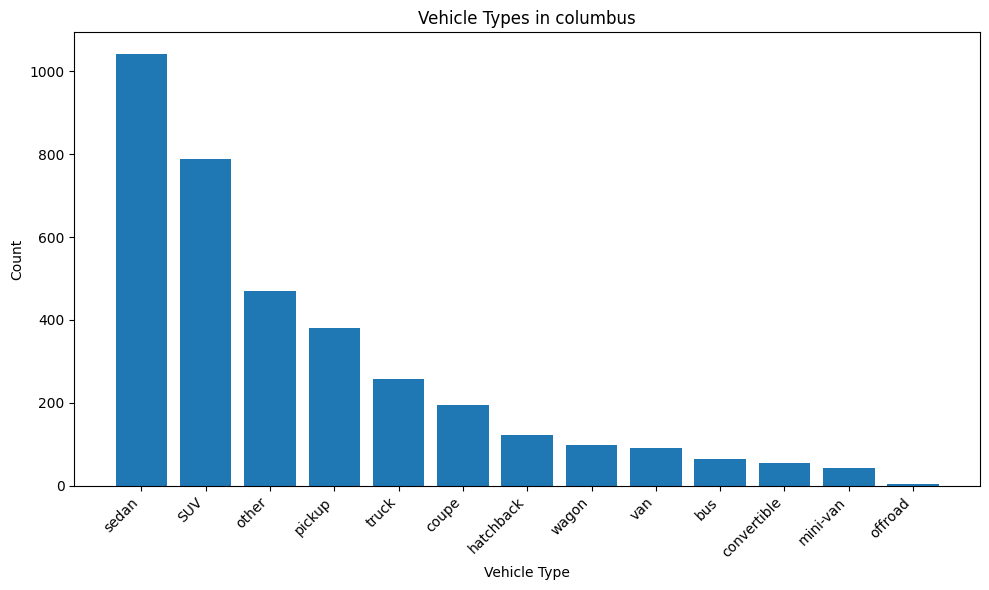

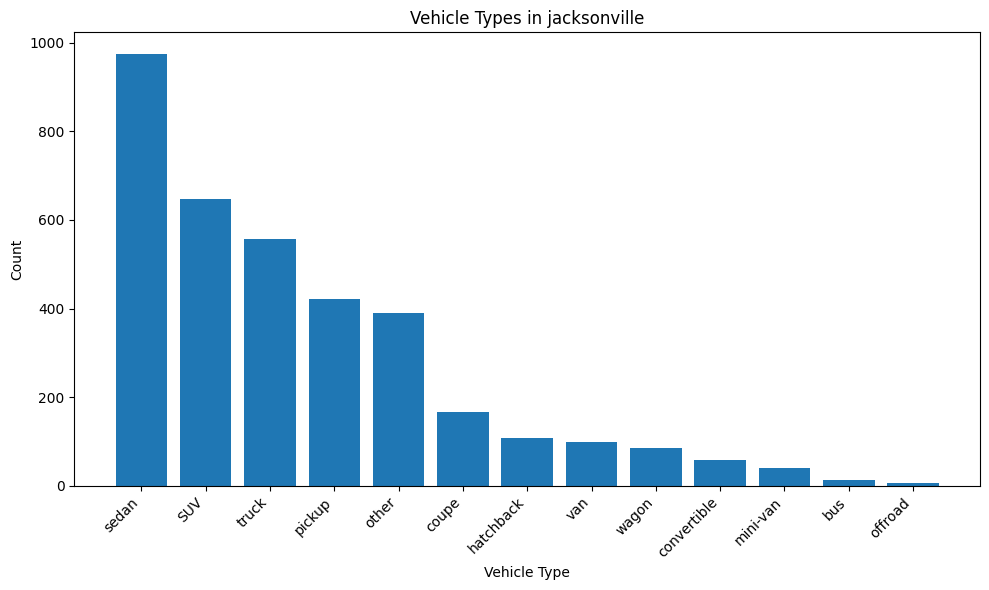

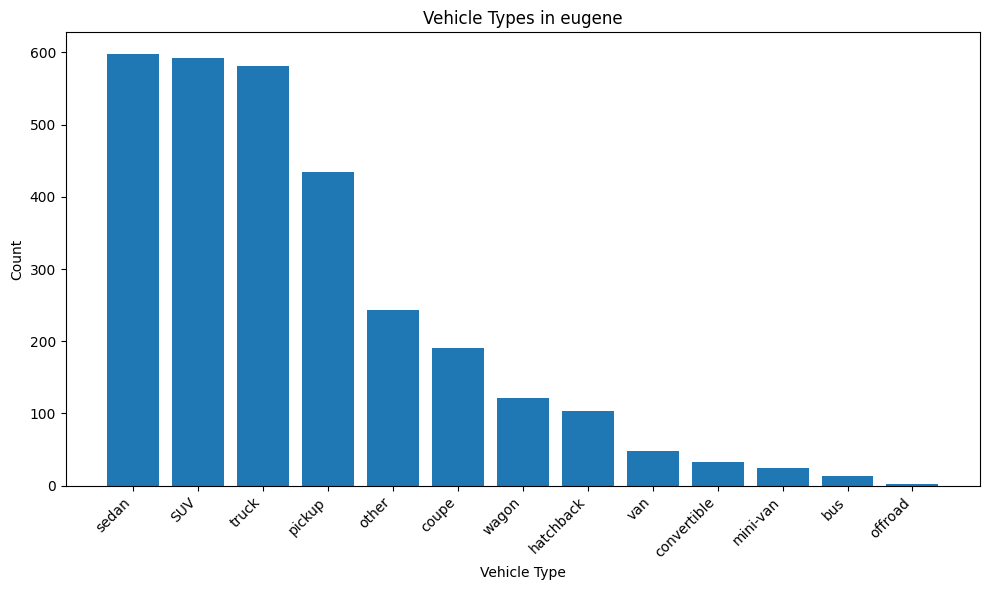

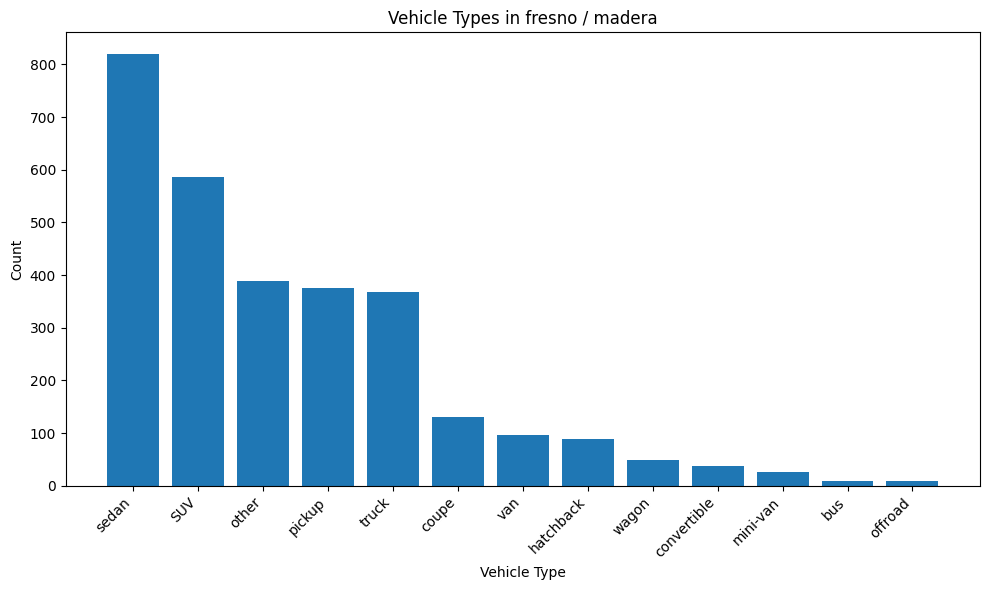

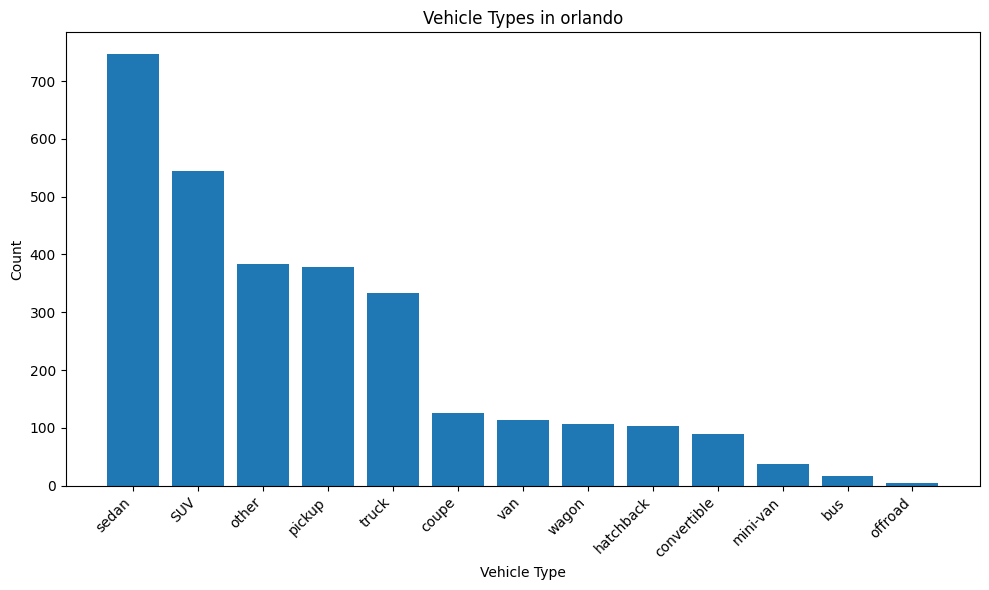

...

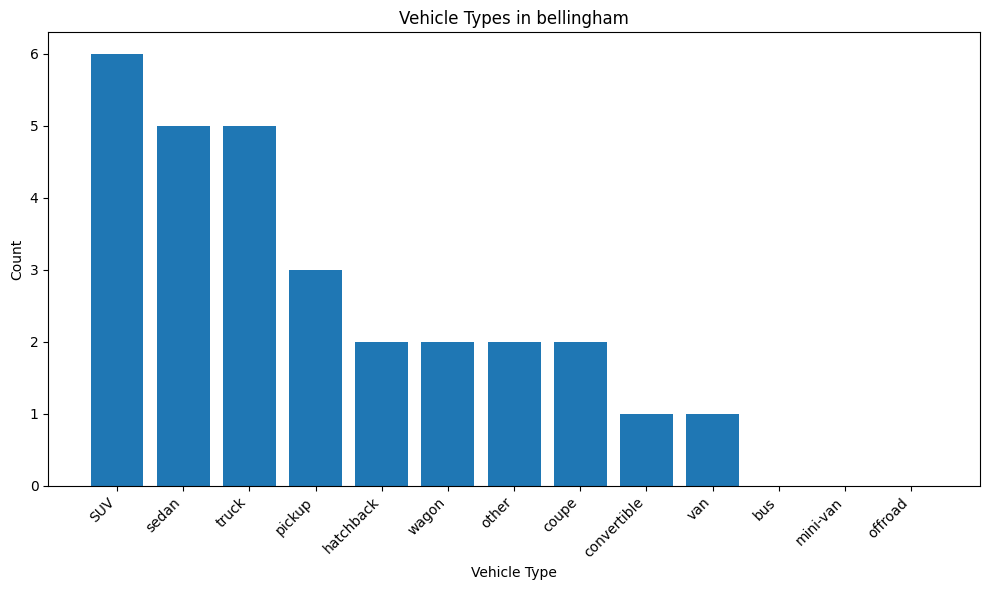

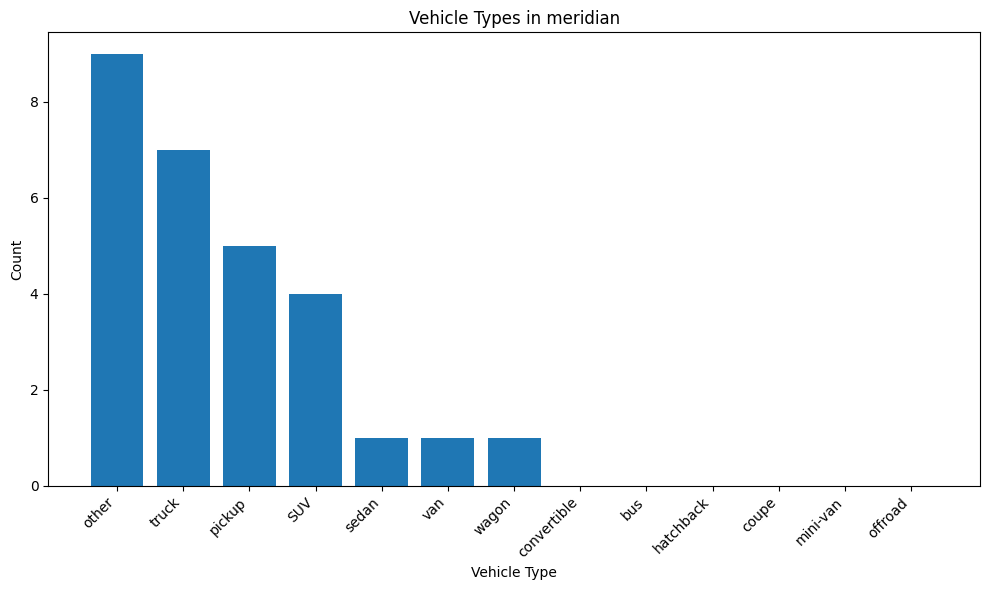

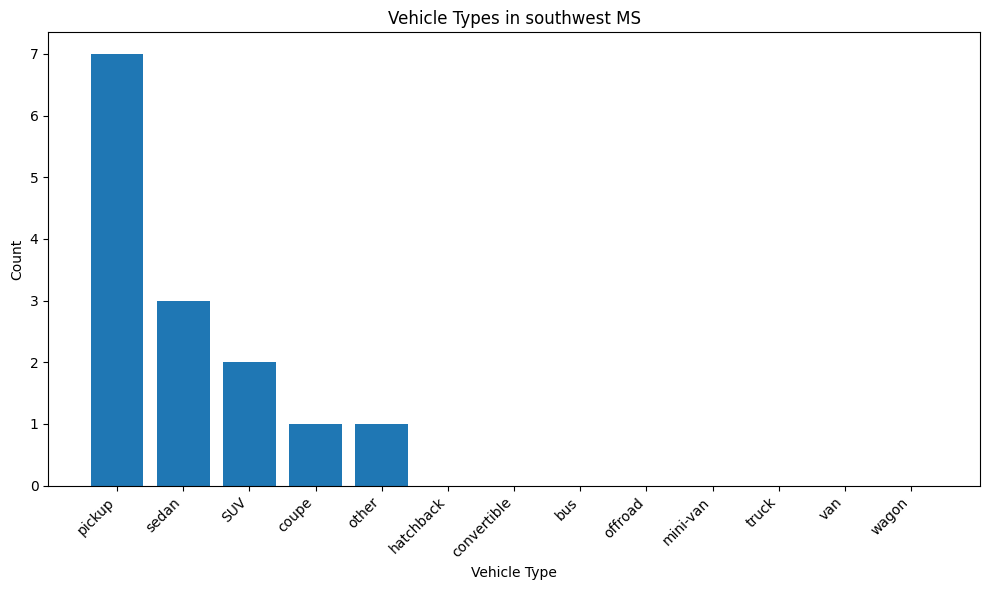

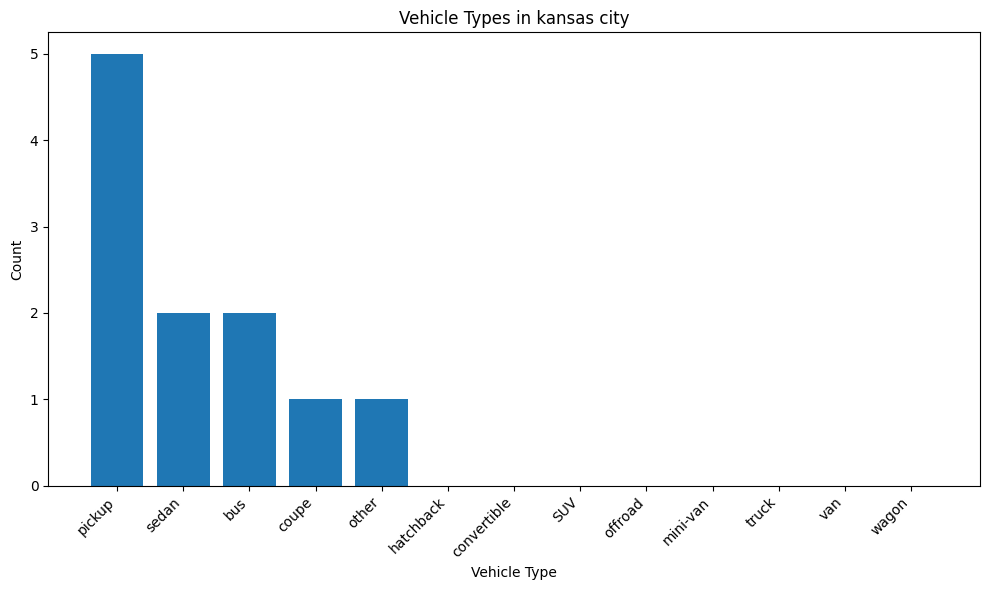

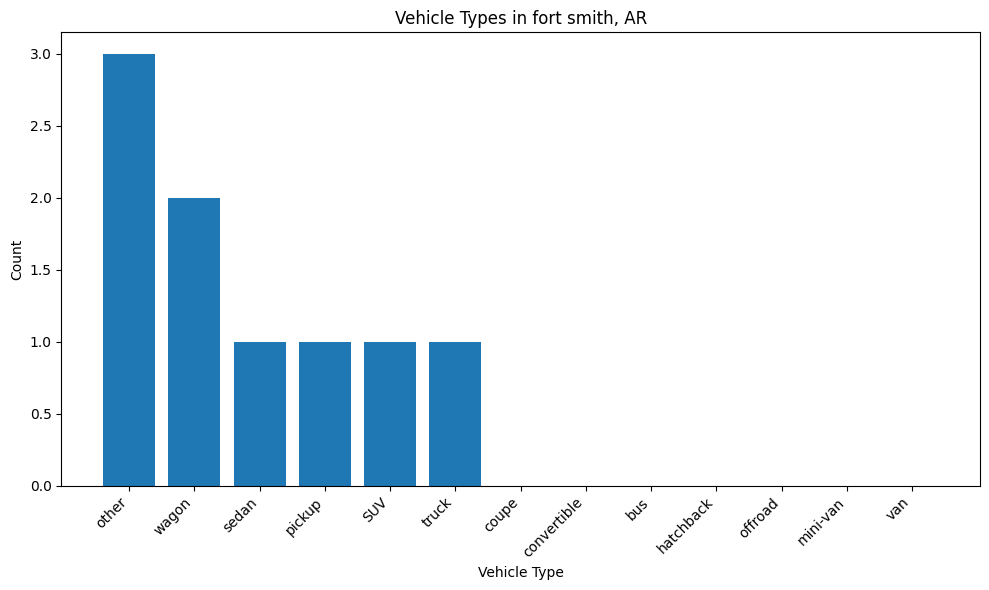

In [ ]:

# Group by region and type, then count occurrences
type_counts_by_region = data.groupby(['region', 'type']).size().unstack(fill_value=0)

# Sort regions by the total number of vehicles in descending order
total_vehicles_by_region = type_counts_by_region.sum(axis=1)
sorted_regions = total_vehicles_by_region.sort_values(ascending=False).index

# Create individual plots for each region, sorted by total vehicle count
for region in sorted_regions:
    region_data = type_counts_by_region.loc[region]
    sorted_types = region_data.sort_values(ascending=False)

    plt.figure(figsize=(10, 6))  # Adjust figure size as needed
    plt.bar(sorted_types.index, sorted_types.values)
    plt.title(f'Vehicle Types in {region}')
    plt.xlabel('Vehicle Type')
    plt.ylabel('Count')
    plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
    plt.tight_layout()  # Adjust layout to prevent labels from overlapping
    plt.show()

In [ ]:

# Find top vehicle types per region
top_types = data.groupby('region')['type'].agg(lambda x: x.value_counts().idxmax())

# Visualize the most common vehicle type in each region
plt.figure(figsize=(100, 90))
sns.countplot(y='region', hue='type', data=data, order=top_types.index)
plt.title('Most Common Vehicle Types in Each Region')
plt.xlabel('Count')
plt.ylabel('Region')
plt.show()

# ***How does odometer reading correlate with price?***

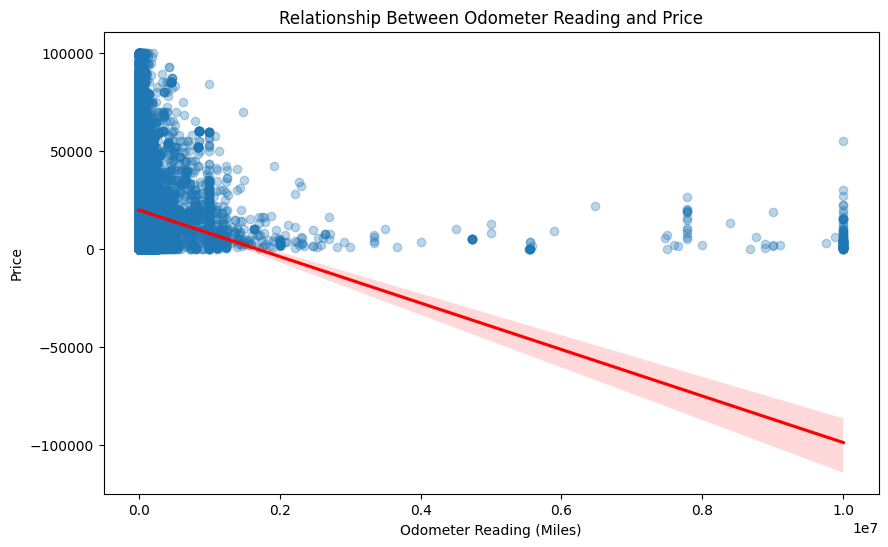

In [ ]:
# How does odometer reading correlate with price?

# Filter for valid odometer and price values
filtered_data = data[(data['odometer'] > 0) & (data['price'] > 0) & (data['price'] <= 100000)]

# Scatter plot with regression line
plt.figure(figsize=(10, 6))
sns.regplot(x='odometer', y='price', data=filtered_data, scatter_kws={'alpha': 0.3}, line_kws={"color": "red"})
plt.title('Relationship Between Odometer Reading and Price')
plt.xlabel('Odometer Reading (Miles)')
plt.ylabel('Price')
plt.show()

# ***manufacturers with the highest average prices and occurances***


1.   What manufacturers dominate the listings?
2.   What manufacturers with higher prices?



In [ ]:
# What manufacturers dominate the listings?
manufacturer_counts = data['manufacturer'].value_counts()
print(manufacturer_counts)

manufacturer
ford               67562
chevrolet          52037
toyota             33538
honda              20256
ram                19059
nissan             18288
jeep               17667
gmc                17049
bmw                13591
dodge              12869
mercedes-benz      11370
hyundai             9887
volkswagen          8875
subaru              8799
kia                 8037
lexus               7896
audi                7554
unknown             7420
cadillac            6616
chrysler            5783
acura               5713
mazda               5221
buick               5217
infiniti            4590
lincoln             4095
volvo               3284
mitsubishi          2985
mini                2417
pontiac             2169
rover               1945
jaguar              1874
porsche             1272
mercury             1138
saturn              1014
alfa-romeo           845
tesla                817
fiat                 773
harley-davidson      151
ferrari              115
datsun      

Top 10 manufacturers with Highest Average Prices:
manufacturer
mercedes-benz    551730.616711
volvo            394130.831303
toyota           238467.839555
jeep             160391.259523
chevrolet        123589.542883
ferrari           92620.713043
aston-martin      56522.857143
tesla             38678.957160
buick             38112.605329
ford              37076.325538
Name: price, dtype: float64


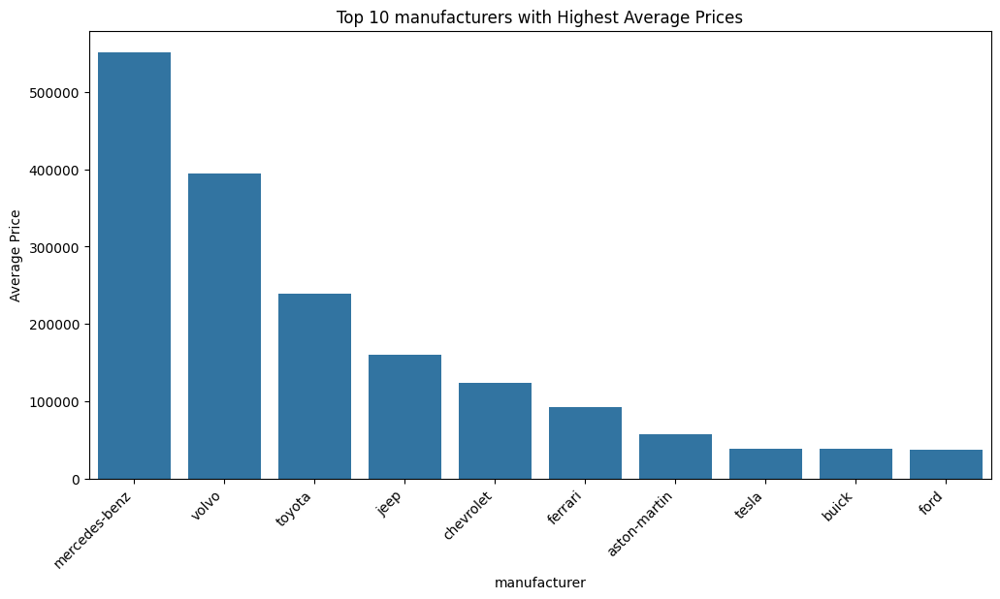

In [ ]:
#What manufacturers with higher prices?
# Group data by 'manufacturers' and calculate the mean price for each Condition
manufacturer_prices = data.groupby('manufacturer')['price'].mean().sort_values(ascending=False)

# Print the top 10 manufacturers with the highest average prices
print("Top 10 manufacturers with Highest Average Prices:")
print(manufacturer_prices.head(10))


plt.figure(figsize=(12, 6))
sns.barplot(x=manufacturer_prices.head(10).index, y=manufacturer_prices.head(10).values)
plt.xticks(rotation=45, ha='right')
plt.xlabel("manufacturer")
plt.ylabel("Average Price")
plt.title("Top 10 manufacturers with Highest Average Prices")
plt.show()

# ***top conditions with the highest average prices***


1.   What conditions dominate the listings?
2.   What conditions with higher prices?




In [ ]:
# Count vehicles by condition
condition_counts = data['condition'].value_counts()
print(condition_counts)

condition
good         171642
excellent    104303
unknown       62428
like new      26883
new           22824
fair          10121
salvage        1727
Name: count, dtype: int64


Top 10 conditions with Highest Average Prices:
condition
fair         516467.345124
unknown      206024.995467
excellent     50535.640634
good          39325.733661
like new      33517.754343
new           23491.575535
salvage       10695.777070
Name: price, dtype: float64


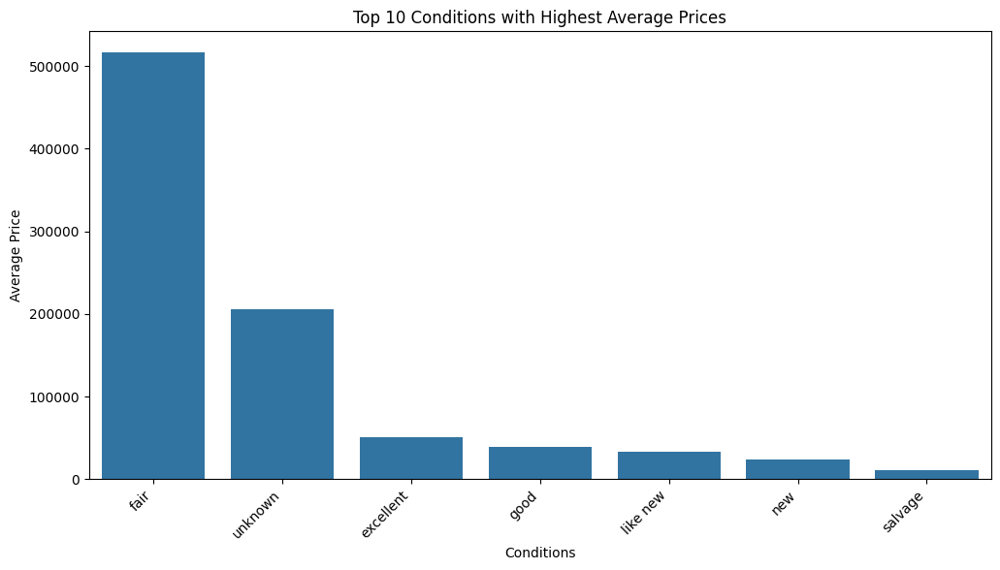

In [ ]:

# Group data by 'Conditions' and calculate the mean price for each Condition
condition_prices = data.groupby('condition')['price'].mean().sort_values(ascending=False)

# Print the top 10 manufacturers with the highest average prices
print("Top 10 conditions with Highest Average Prices:")
print(condition_prices.head(10))


plt.figure(figsize=(12, 6))
sns.barplot(x=condition_prices.head(10).index, y=condition_prices.head(10).values)
plt.xticks(rotation=45, ha='right')
plt.xlabel("Conditions")
plt.ylabel("Average Price")
plt.title("Top 10 Conditions with Highest Average Prices")
plt.show()

# ***How does transmission type vary by region?***


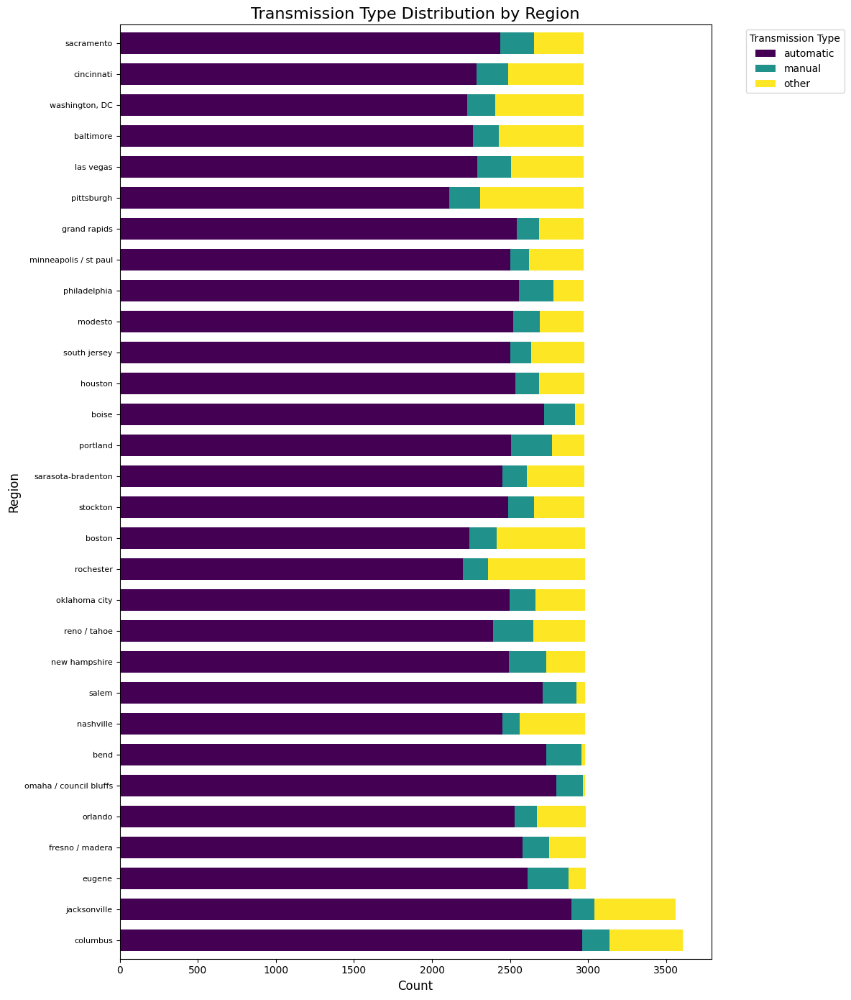

In [ ]:
# Group data by region and transmission type, then count occurrences
transmission_counts_by_region = data.groupby(['region', 'transmission']).size().unstack(fill_value=0)

# Sort by total count of transmissions to display regions with higher counts first
top_regions = transmission_counts_by_region.sum(axis=1).sort_values(ascending=False).head(30)
transmission_counts_by_region = transmission_counts_by_region.loc[top_regions.index]

# Plot horizontal stacked bars with adjusted spacing
fig, ax = plt.subplots(figsize=(12, 14))

transmission_counts_by_region.plot(kind='barh', stacked=True, ax=ax, width=0.7, colormap='viridis')

plt.title('Transmission Type Distribution by Region', fontsize=16)
plt.xlabel('Count', fontsize=12)
plt.ylabel('Region', fontsize=12)

# Adjust legend to avoid overlap
plt.legend(title='Transmission Type', bbox_to_anchor=(1.05, 1), loc='upper left')

# Fine-tune tick label size for clarity
plt.xticks(fontsize=10)
plt.yticks(fontsize=8)

# Adjust layout to avoid clipping
plt.tight_layout()
plt.show()



# ***get all the vechiles that have the same the highest price***


In [ ]:
#what is the vehicle with the highest price ?
highest_price_vehicle = data.sort_values('price', ascending=False).iloc[0]
print("\nHighest price vehicle :")
highest_price_vehicle


Highest price vehicle :


,318525
region,eugene
price,3736928711
year,2007.0
manufacturer,toyota
model,tundra
condition,excellent
cylinders,8 cylinders
fuel,gas
odometer,164000.0
title_status,clean


In [ ]:

# Find the highest price
max_price = data['price'].max()

# Get all vehicles with the highest price
highest_price_vehicles = data[data['price'] == max_price]

# Display the vehicles
highest_price_vehicles

,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,...,drive,size,type,paint_color,description,state,lat,long,posting_date,vehicle_age
318525,eugene,3736928711,2007.0,toyota,tundra,excellent,8 cylinders,gas,164000.0,clean,...,4wd,full-size,pickup,silver,Selling my 2007 Toyota Tundra SR5 four wheel d...,or,44.066092,-124.037561,2021-04-16T18:16:12-0700,17.0
356647,knoxville,3736928711,1999.0,toyota,4runner,fair,6 cylinders,gas,211000.0,clean,...,4wd,mid-size,truck,green,"99 four runner 211,000 miles runs great 4x4 wo...",tn,36.081000,-83.567300,2021-04-05T23:15:48-0400,25.0


# ***posting date relations***

In [ ]:
print(data['posting_date'])

0         2021-05-04T12:31:18-0500
1         2021-05-04T12:31:08-0500
2         2021-05-04T12:31:25-0500
3         2021-05-04T10:41:31-0500
4         2021-05-03T14:02:03-0500
                    ...           
399923    2021-05-04T11:44:10-0700
399924    2021-05-04T11:19:42-0700
399925    2021-05-04T11:10:50-0700
399926    2021-05-04T11:01:26-0700
399927    2021-05-04T10:00:27-0700
Name: posting_date, Length: 399928, dtype: object


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 399928 entries, 0 to 399927
Data columns (total 22 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   region        399928 non-null  object 
 1   price         399928 non-null  int64  
 2   year          399928 non-null  float64
 3   manufacturer  399928 non-null  object 
 4   model         399928 non-null  object 
 5   condition     399928 non-null  object 
 6   cylinders     399928 non-null  object 
 7   fuel          399928 non-null  object 
 8   odometer      399928 non-null  float64
 9   title_status  399928 non-null  object 
 10  transmission  399928 non-null  object 
 11  VIN           246882 non-null  object 
 12  drive         399928 non-null  object 
 13  size          399928 non-null  object 
 14  type          399928 non-null  object 
 15  paint_color   399928 non-null  object 
 16  description   399928 non-null  object 
 17  state         399928 non-null  object 
 18  lat 

In [ ]:
# Convert 'posting_date' to datetime objects
data['posting_date'] = pd.to_datetime(data['posting_date'], utc=True) # Added utc=True

# Extract day, month, and year
data['day'] = data['posting_date'].dt.day
data['month'] = data['posting_date'].dt.month
data['yearp'] = data['posting_date'].dt.year

# Extract hour
data['hour'] = data['posting_date'].dt.hour

# Define time categories
def categorize_time(hour):
    if 6 <= hour < 12:
        return 'Morning'
    elif 12 <= hour < 18:
        return 'Afternoon'
    elif 18 <= hour < 22:
        return 'Evening'
    else:
        return 'Night'

# Apply time categorization
data['timing'] = data['hour'].apply(categorize_time)

print(data[['posting_date', 'day', 'month', 'yearp', 'timing']].head())

               posting_date  day  month  yearp     timing
0 2021-05-04 17:31:18+00:00    4      5   2021  Afternoon
1 2021-05-04 17:31:08+00:00    4      5   2021  Afternoon
2 2021-05-04 17:31:25+00:00    4      5   2021  Afternoon
3 2021-05-04 15:41:31+00:00    4      5   2021  Afternoon
4 2021-05-03 19:02:03+00:00    3      5   2021    Evening


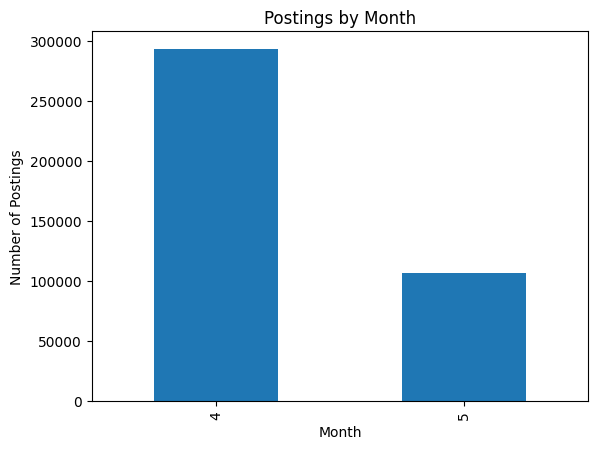

In [ ]:

# Plot postings by month
postings_by_month = data['month'].value_counts().sort_index()
postings_by_month.plot(kind='bar', title='Postings by Month')
plt.xlabel('Month')
plt.ylabel('Number of Postings')
plt.show()

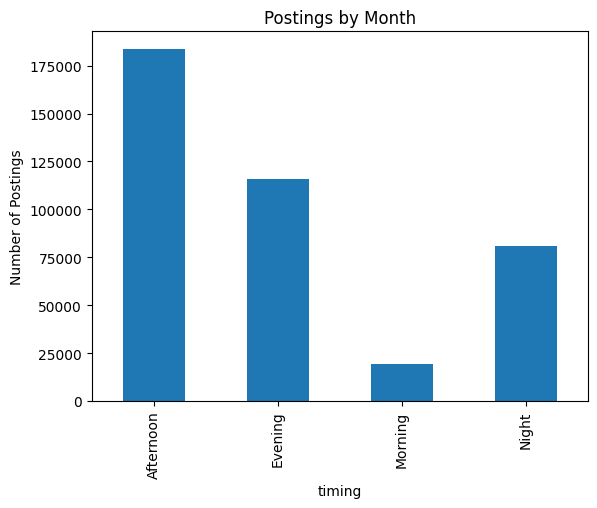

In [ ]:
postings_by_timing = data['timing'].value_counts().sort_index()
postings_by_timing.plot(kind='bar', title='Postings by Month')
plt.xlabel('timing')
plt.ylabel('Number of Postings')
plt.show()

# ***Are there any duplicate VINs in the dataset?***

In [ ]:
vins_check = data.copy()
vins_check.dropna(inplace=True)
vins_check.drop_duplicates(subset=['model'], inplace=True)
# Check for duplicate VINs
duplicate_vins = vins_check['VIN'].duplicated()
num_duplicate_vins = duplicate_vins.sum()

print(f"Number of duplicate VINs: {num_duplicate_vins}")

if num_duplicate_vins > 0:
    print("more than one model has the same VIN")
    print("\nDuplicate VINs:")
    print(vins_check[duplicate_vins]['VIN'])

Number of duplicate VINs: 265
more than one model has the same VIN

Duplicate VINs:
753       JM1BL1SFXA1196709
3916      1N4AL3AP6EN221725
3962      3VWSF31Y69M412685
5290      1C3CDZBG3DN502899
6507      2HKRW2H87HH666833
                ...        
391683    WDBUH83J16X190760
391812        235077P268158
394197    3N63M0ZN4FK710243
394795    1GJZ7LF14L1153623
395780    4S7AT3897XC032273
Name: VIN, Length: 265, dtype: object


# ***correlation of numerical features***

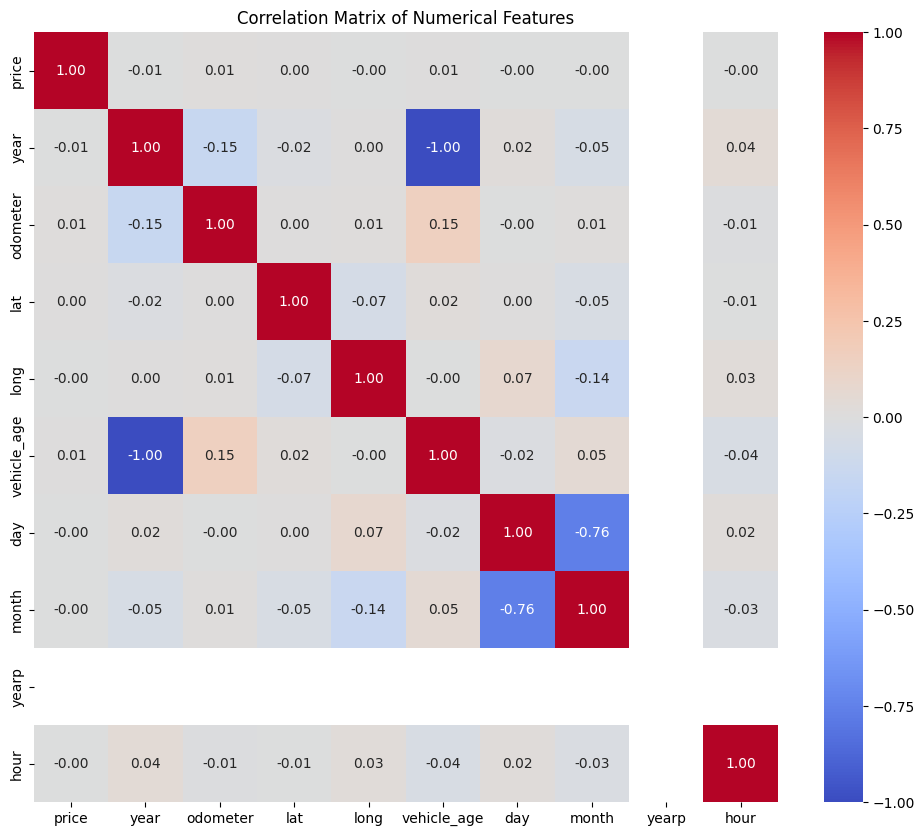

In [ ]:

# Correlation matrix for numerical features
numerical_features = data.select_dtypes(include=np.number).columns.tolist()
correlation_matrix = data[numerical_features].corr()

# Visualize the correlation matrix as a heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix of Numerical Features')
plt.show()